# Initial file upload: TMDB_tv_dataset_v3.csv

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
import nbformat

# Path ל-notebook הנוכחי
path = '/content/drive/MyDrive/Colab Notebooks/Copy_of_GitHub_1_TV_show_popularity_part_one.ipynb'  # שנה לפי הנתיב שלך

# קריאה ועריכה של ה-notebook
nb = nbformat.read(path, as_version=4)

# ניקוי metadata בעייתית
if "widgets" in nb.metadata:
    del nb.metadata["widgets"]
if "colab" in nb.metadata:
    del nb.metadata["colab"]
if "celltoolbar" in nb.metadata:
    del nb.metadata["celltoolbar"]

# שמירה מחדש
nbformat.write(nb, path)
print("✅ Notebook cleaned and ready for GitHub!")

✅ Notebook cleaned and ready for GitHub!


In [ ]:
import pandas as pd

df = pd.read_csv(r"TMDB_tv_dataset_v3.csv")

In [ ]:
import matplotlib as plt
%matplotlib inline

import numpy as np
import seaborn as sb
import warnings

# Step 1: Data Preparation



In [ ]:
# To have an overview of the dataset
df.describe()

,id,number_of_seasons,number_of_episodes,vote_count,vote_average,popularity,episode_run_time
count,168639.000000,168639.000000,168639.000000,168639.000000,168639.000000,168639.000000,168639.000000
mean,111307.074704,1.548497,24.465082,13.305054,2.333843,5.882644,22.603348
std,76451.662352,2.942872,134.799622,190.809059,3.454334,42.023216,47.950427
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,45936.500000,1.000000,1.000000,0.000000,0.000000,0.600000,0.000000
50%,97734.000000,1.000000,6.000000,0.000000,0.000000,0.857000,0.000000
75%,196923.500000,1.000000,20.000000,1.000000,6.000000,2.431500,42.000000
max,251213.000000,240.000000,20839.000000,21857.000000,10.000000,3707.008000,6032.000000


In [ ]:
# To have an overview of missing data and types of data

# ניצור טבלת סיכום מקיפה לכל עמודה
summary = pd.DataFrame({
    'non_null_count': df.notnull().sum(),
    'null_percent': df.isnull().mean() * 100,
    'num_unique': df.nunique(),
    'data_type': df.dtypes,
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      non_null_count  null_percent  num_unique data_type
tagline                         5330     96.839403        5267    object
created_by                     36496     78.358505       26081    object
homepage                       50998     69.759071       49758    object
production_companies           59342     64.811224       27132    object
production_countries           77511     54.037322        1247    object
backdrop_path                  77780     53.877810       76300    object
overview                       93333     44.655151       91243    object
networks                       97589     42.131417        8196    object
genres                         99713     40.871922        2228    object
poster_path                   108737     35.520846      106050    object
spoken_languages              109280     35.198857         946    object
languages                     110050     34.742260        1113    object
first_air_date                136903     18.818897 

In [ ]:
df.head()

,id,name,number_of_seasons,number_of_episodes,original_language,vote_count,vote_average,overview,adult,backdrop_path,first_air_date,last_air_date,homepage,in_production,original_name,popularity,poster_path,type,status,tagline,genres,created_by,languages,networks,origin_country,spoken_languages,production_companies,production_countries,episode_run_time
0,1399,Game of Thrones,8,73,en,21857,8.442,Seven noble families fight for control of the ...,False,/2OMB0ynKlyIenMJWI2Dy9IWT4c.jpg,2011-04-17,2019-05-19,http://www.hbo.com/game-of-thrones,False,Game of Thrones,1083.917,/1XS1oqL89opfnbLl8WnZY1O1uJx.jpg,Scripted,Ended,Winter Is Coming,"Sci-Fi & Fantasy, Drama, Action & Adventure","David Benioff, D.B. Weiss",en,HBO,US,English,"Revolution Sun Studios, Television 360, Genera...","United Kingdom, United States of America",0
1,71446,Money Heist,3,41,es,17836,8.257,"To carry out the biggest heist in history, a m...",False,/gFZriCkpJYsApPZEF3jhxL4yLzG.jpg,2017-05-02,2021-12-03,https://www.netflix.com/title/80192098,False,La Casa de Papel,96.354,/reEMJA1uzscCbkpeRJeTT2bjqUp.jpg,Scripted,Ended,The perfect robbery.,"Crime, Drama",Álex Pina,es,"Netflix, Antena 3",ES,Español,Vancouver Media,Spain,70
2,66732,Stranger Things,4,34,en,16161,8.624,"When a young boy vanishes, a small town uncove...",False,/2MaumbgBlW1NoPo3ZJO38A6v7OS.jpg,2016-07-15,2022-07-01,https://www.netflix.com/title/80057281,True,Stranger Things,185.711,/49WJfeN0moxb9IPfGn8AIqMGskD.jpg,Scripted,Returning Series,Every ending has a beginning.,"Drama, Sci-Fi & Fantasy, Mystery","Matt Duffer, Ross Duffer",en,Netflix,US,English,"21 Laps Entertainment, Monkey Massacre Product...",United States of America,0
3,1402,The Walking Dead,11,177,en,15432,8.121,Sheriff's deputy Rick Grimes awakens from a co...,False,/x4salpjB11umlUOltfNvSSrjSXm.jpg,2010-10-31,2022-11-20,http://www.amc.com/shows/the-walking-dead--100...,False,The Walking Dead,489.746,/n7PVu0hSz2sAsVekpOIoCnkWlbn.jpg,Scripted,Ended,Fight the dead. Fear the living.,"Action & Adventure, Drama, Sci-Fi & Fantasy",Frank Darabont,en,AMC,US,English,"AMC Studios, Circle of Confusion, Valhalla Mot...",United States of America,42
4,63174,Lucifer,6,93,en,13870,8.486,"Bored and unhappy as the Lord of Hell, Lucifer...",False,/aDBRtunw49UF4XmqfyNuD9nlYIu.jpg,2016-01-25,2021-09-10,https://www.netflix.com/title/80057918,False,Lucifer,416.668,/ekZobS8isE6mA53RAiGDG93hBxL.jpg,Scripted,Ended,It's good to be bad.,"Crime, Sci-Fi & Fantasy",Tom Kapinos,en,"FOX, Netflix",US,English,"Warner Bros. Television, DC Entertainment, Jer...",United States of America,45


In [ ]:
# Show all columns
pd.set_option('display.max_columns', None)
print(df.head(10))

      id              name  number_of_seasons  number_of_episodes  \
0   1399   Game of Thrones                  8                  73   
1  71446       Money Heist                  3                  41   
2  66732   Stranger Things                  4                  34   
3   1402  The Walking Dead                 11                 177   
4  63174           Lucifer                  6                  93   
5  69050         Riverdale                  7                 137   
6  93405        Squid Game                  2                   9   
7   1396      Breaking Bad                  5                  62   
8  71712   The Good Doctor                  6                 116   
9  85271       WandaVision                  1                   9   

  original_language  vote_count  vote_average  \
0                en       21857         8.442   
1                es       17836         8.257   
2                en       16161         8.624   
3                en       15432         8.12

## Look at rows and columns - Rows and columns duplication, check nulls and unknown - to

---

remove them

In [ ]:
# חיפוש עמודות זהות - לא נמצאו
# To see columns with duplicate content - Didn't find any!
# יצירת רשימה לאחסון זוגות עמודות עם תוכן כפול
duplicate_content = []

# לולאה על כל זוגות עמודות
for i in range(len(df.columns)):
    for j in range(i+1, len(df.columns)):
        col1 = df.columns[i]
        col2 = df.columns[j]
        if df[col1].equals(df[col2]):
            duplicate_content.append((col1, col2))

print("Columns with duplicate content:", duplicate_content)

Columns with duplicate content: []


In [ ]:
# Screen for duplication whole row - by three parameters: id, name, original_name
# חיפוש שורות עם אותו id, name, original_name - נמצאו ובהמשך נמחק אחד מהם
# לפי שלושת הפרמטרים האלה כי זה חוסך זמן הרצה
# ----------------------------
# חלק 1 – בדיקה והצגת כפילויות
# ----------------------------

# 1️⃣ מציאת כל השורות הכפולות לפי עמודות ספציפיות
duplicate_rows = df[df.duplicated(subset=['id', 'name', 'original_name'], keep=False)]

# 2️⃣ מיון התוצאות כדי שיהיה קל לראות את הכפילויות
duplicate_rows = duplicate_rows.sort_values(by=['id', 'name', 'original_name'])

# 3️⃣ הצגת 10 דוגמאות ראשונות של כפילויות
print("דוגמאות של כפילויות:")
print(duplicate_rows.head(10))

# 4️⃣ הדפסת מספר השורות הכולל שמזוהות ככפולות
num_duplicates = len(duplicate_rows)
print(f"\nנמצאו {num_duplicates} שורות כפולות (כולל כל העותקים).")

דוגמאות של כפילויות:
            id                          name  number_of_seasons  \
97167   237050             Archives secrètes                  1   
164937  237050             Archives secrètes                  1   
97238   237051  Sefure no Hinkaku The Series                  1   
164938  237051  Sefure no Hinkaku The Series                  1   
97152   237052                 Les Disparues                  1   
164947  237052                 Les Disparues                  1   
88129   237053           KEY is Good & Great                  1   
164940  237053           KEY is Good & Great                  1   
97110   237054             Sådan er det bare                  1   
164942  237054             Sådan er det bare                  1   

        number_of_episodes original_language  vote_count  vote_average  \
97167                    5                fr           0           0.0   
164937                   5                fr           0           0.0   
97238              

In [ ]:
# חלק 2 – הסרת כל הכפילויות

# Combine repeated rows into one - New df copy for this process: df_unique

# מספר השורות המקורי
original_rows = len(df)

# ----------------------------
# הסרת כל הכפילויות, שמירה על מופע אחד לכל שילוב של ['id', 'name', 'original_name']
# ----------------------------
df_unique = df.drop_duplicates(subset=['id', 'name', 'original_name']).reset_index(drop=True)

# חישוב מספר השורות הלא ייחודיות שהוסרו
removed_rows = original_rows - len(df_unique)

# הצגה מהירה של התוצאה
print("\nתוצאות לאחר הסרת כפילויות:")
print(df_unique.head())
print(f"סה\"כ שורות ייחודיות: {len(df_unique)}")
print(f"סה\"כ שורות לא ייחודיות שנמחקו: {removed_rows}")


תוצאות לאחר הסרת כפילויות:
      id              name  number_of_seasons  number_of_episodes  \
0   1399   Game of Thrones                  8                  73   
1  71446       Money Heist                  3                  41   
2  66732   Stranger Things                  4                  34   
3   1402  The Walking Dead                 11                 177   
4  63174           Lucifer                  6                  93   

  original_language  vote_count  vote_average  \
0                en       21857         8.442   
1                es       17836         8.257   
2                en       16161         8.624   
3                en       15432         8.121   
4                en       13870         8.486   

                                            overview  adult  \
0  Seven noble families fight for control of the ...  False   
1  To carry out the biggest heist in history, a m...  False   
2  When a young boy vanishes, a small town uncove...  False   
3  Sheriff

# New data file name: df_unique

In [ ]:
print(f"מספר העמודות: {len(df_unique.columns)}")
print("שמות העמודות:")
print(df_unique.columns)

מספר העמודות: 29
שמות העמודות:
Index(['id', 'name', 'number_of_seasons', 'number_of_episodes',
       'original_language', 'vote_count', 'vote_average', 'overview', 'adult',
       'backdrop_path', 'first_air_date', 'last_air_date', 'homepage',
       'in_production', 'original_name', 'popularity', 'poster_path', 'type',
       'status', 'tagline', 'genres', 'created_by', 'languages', 'networks',
       'origin_country', 'spoken_languages', 'production_companies',
       'production_countries', 'episode_run_time'],
      dtype='object')


# Explore target - popularity

In [ ]:
df_unique['popularity'].describe()

,popularity
count,164769.000000
mean,5.960236
std,42.480385
min,0.000000
25%,0.600000
50%,0.863000
75%,2.455000
max,3707.008000


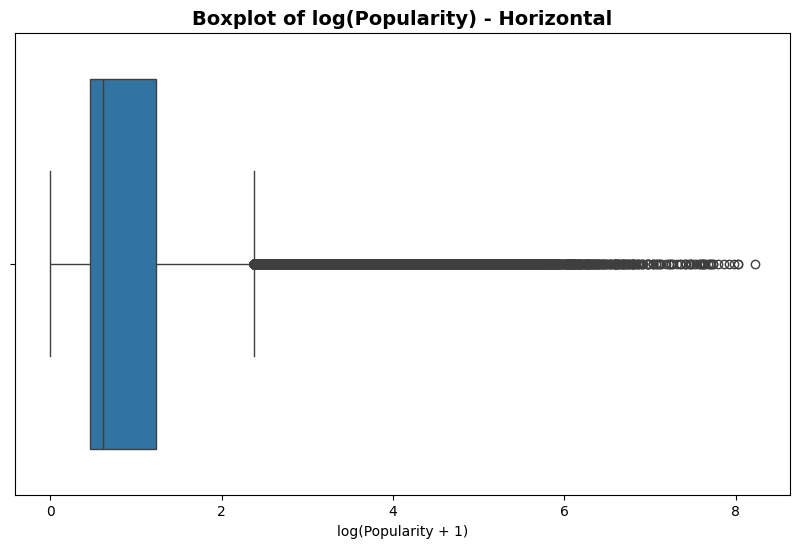

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

plt.figure(figsize=(10, 6))
sns.boxplot(x=np.log1p(df['popularity']))  # נתונים מופיעים על ציר X
plt.title('Boxplot of log(Popularity) - Horizontal', fontsize=14, weight='bold')
plt.xlabel('log(Popularity + 1)')
plt.show()


/tmp/ipython-input-456912558.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='log_popularity', y='popularity_3cat', data=df, palette='Set2')


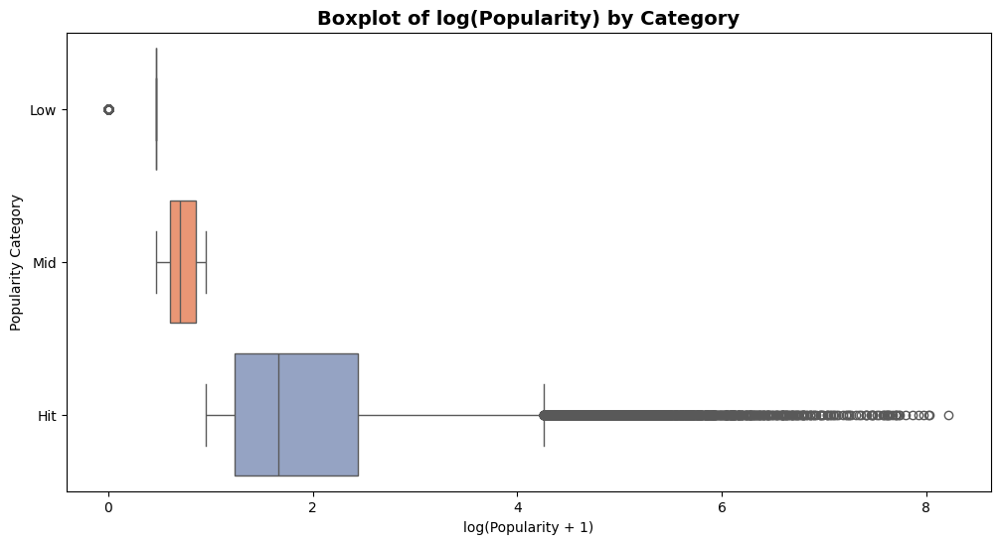

In [ ]:
"""
# לא שייך לכאן!!!!!!!!!!!!!!!1

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# אם אין עדיין עמודת קטגוריה, אפשר ליצור:
labels = ['Low', 'Mid', 'Hit']
df['popularity_3cat'] = pd.qcut(df['popularity'], q=3, labels=labels)

# יוצרים עמודת לוגריתם זמנית
df['log_popularity'] = np.log1p(df['popularity'])

plt.figure(figsize=(12, 6))
sns.boxplot(x='log_popularity', y='popularity_3cat', data=df, palette='Set2')
plt.title('Boxplot of log(Popularity) by Category', fontsize=14, weight='bold')
plt.xlabel('log(Popularity + 1)')
plt.ylabel('Popularity Category')
plt.show()
"""

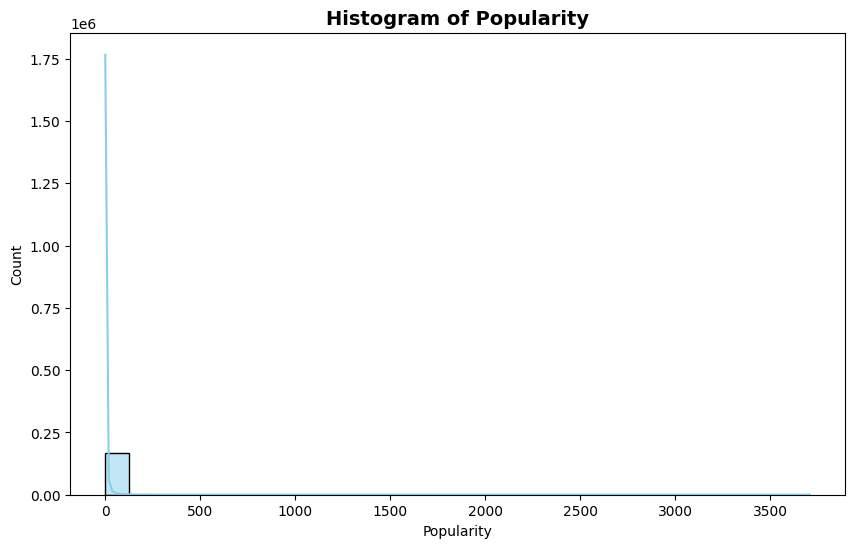

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df['popularity'], bins=30, kde=True, color='skyblue')
plt.title('Histogram of Popularity', fontsize=14, weight='bold')
plt.xlabel('Popularity')
plt.ylabel('Count')
plt.show()


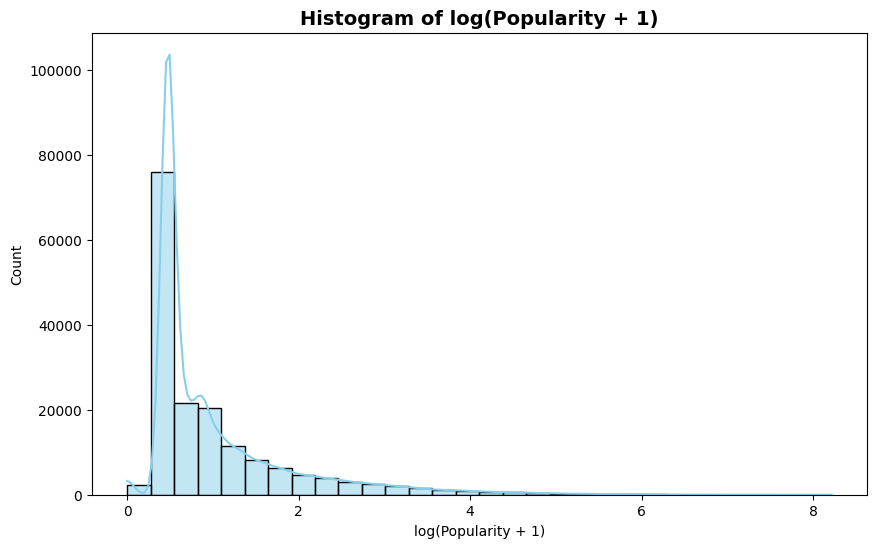

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(df['popularity']), bins=30, kde=True, color='skyblue')
plt.title('Histogram of log(Popularity + 1)', fontsize=14, weight='bold')
plt.xlabel('log(Popularity + 1)')
plt.ylabel('Count')
plt.show()


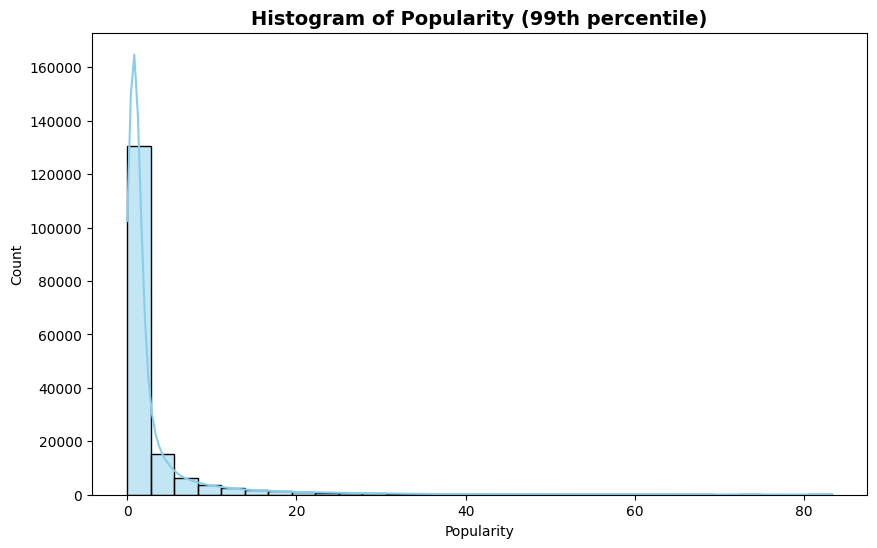

In [ ]:
pop_max = df['popularity'].quantile(0.99)
plt.figure(figsize=(10, 6))
sns.histplot(df[df['popularity'] <= pop_max]['popularity'], bins=30, kde=True, color='skyblue')
plt.title('Histogram of Popularity (99th percentile)', fontsize=14, weight='bold')
plt.xlabel('Popularity')
plt.ylabel('Count')
plt.show()


<Axes: >

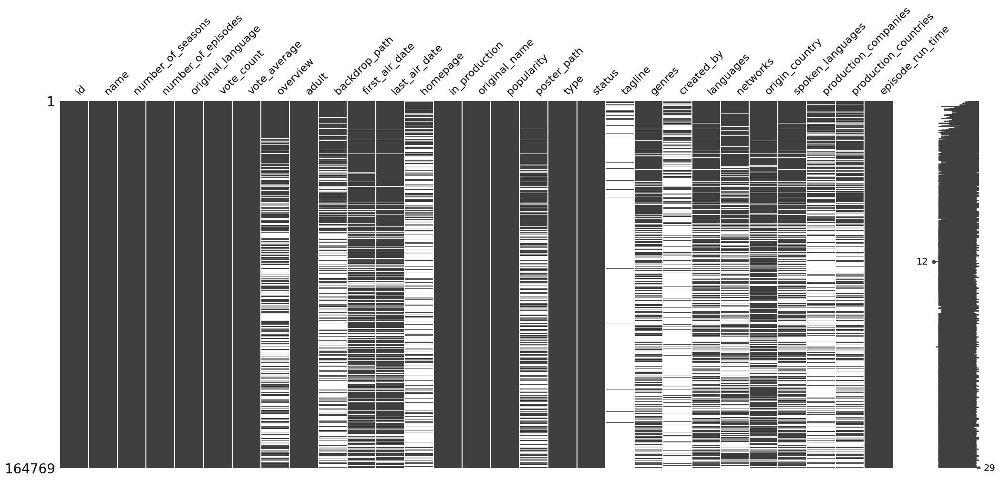

In [ ]:
# Check overall nulls
import missingno as msno
msno.matrix(df_unique)

In [ ]:
# Checking nulls by percentage
missing_percent = df_unique.isnull().mean() * 100
print(missing_percent.sort_values(ascending=False))

tagline                 96.791265
created_by              78.236197
homepage                69.398370
production_companies    64.628055
production_countries    53.896061
backdrop_path           53.630234
overview                44.356645
networks                41.595203
genres                  40.811682
poster_path             35.547342
spoken_languages        34.827546
languages               34.372971
origin_country          18.829998
first_air_date          18.759597
last_air_date           17.589474
original_name            0.003035
name                     0.003035
id                       0.000000
number_of_seasons        0.000000
number_of_episodes       0.000000
original_language        0.000000
vote_average             0.000000
vote_count               0.000000
adult                    0.000000
popularity               0.000000
type                     0.000000
status                   0.000000
in_production            0.000000
episode_run_time         0.000000
dtype: float64

# Repeated columns with the same information
## Columns handeling - unit or remove duplicate

In [ ]:
# Repeated columns with the same information
# Second - TV show name and original name

print(df_unique[['name', 'original_name']].head(20))

different_rows = df_unique[df_unique['name'] != df_unique['original_name']]
print(different_rows[['name', 'original_name']].head(20))

                    name         original_name
0        Game of Thrones       Game of Thrones
1            Money Heist      La Casa de Papel
2        Stranger Things       Stranger Things
3       The Walking Dead      The Walking Dead
4                Lucifer               Lucifer
5              Riverdale             Riverdale
6             Squid Game                오징어 게임
7           Breaking Bad          Breaking Bad
8        The Good Doctor       The Good Doctor
9            WandaVision           WandaVision
10             The Flash             The Flash
11   The Big Bang Theory   The Big Bang Theory
12                  Loki                  Loki
13        Grey's Anatomy        Grey's Anatomy
14       The Mandalorian       The Mandalorian
15          The Simpsons          The Simpsons
16              Euphoria              Euphoria
17  The Umbrella Academy  The Umbrella Academy
18        Peaky Blinders        Peaky Blinders
19                 Elite                 Élite
             

In [ ]:

# Coulmns 'name' and 'original_name' - are mostly the same.
# Check for missing values in 'name' column - without the name the row is useless
# ספירת שורות שבהן 'name' חסר

# מציאת השורות שבהן 'name' חסר
missing_name_rows = df_unique[df_unique['name'].isnull()]
missing_name_count = len(missing_name_rows)

print(f"מספר השורות שבהן 'name' חסר: {missing_name_count}")
missing_name_rows[['id', 'name', 'original_name']].head(20)  # תצוגה לדוגמה


מספר השורות שבהן 'name' חסר: 5


,id,name,original_name
72023,117661,NaN,NaN
102657,232283,NaN,NaN
110371,66994,NaN,NaN
121440,68130,NaN,NaN
148926,69260,NaN,NaN


In [ ]:
import numpy as np

# הגדרת תנאי לחסר אמיתי בשם:
# 1. name הוא NaN
# 2. name הוא ריק ("")
# 3. name מכיל רק נקודות, כמו "..." או "....."
missing_name_condition = (
    df_unique['name'].isna() |
    (df_unique['name'].astype(str).str.strip() == "") |
    (df_unique['name'].astype(str).str.match(r'^\.*$'))
)

# שליפת השורות החסרות לפי התנאי
missing_name_rows = df_unique[missing_name_condition]

print(f"מספר השורות שבהן name חסר או בעייתי: {len(missing_name_rows)}")
missing_name_rows[['id', 'name', 'original_name']].head(20)  # תצוגה לדוגמה


מספר השורות שבהן name חסר או בעייתי: 10


,id,name,original_name
72023,117661,NaN,NaN
89421,99006,.....,......
94898,251083,,Дж
101941,229961,..,..
102657,232283,NaN,NaN
109199,87066,.,.
110371,66994,NaN,NaN
121440,68130,NaN,NaN
148226,72299,....,....
148926,69260,NaN,NaN


In [ ]:
# מספר שורות לפני המחיקה
rows_before = len(df_unique)
print(f"סה\"כ שורות לפני המחיקה: {rows_before}")

# תנאי לזיהוי name לא תקין: NaN, ריק, או רק נקודות
missing_name_condition = (
    df_unique['name'].isna() |
    (df_unique['name'].astype(str).str.strip() == "") |
    (df_unique['name'].astype(str).str.match(r'^\.*$'))
)

# שמירת השורות למחיקה (לצפייה או שמירה)
missing_name_rows = df_unique[missing_name_condition]
deleted_ids = missing_name_rows['id'].tolist()

# מחיקת השורות הלא תקינות
df_unique = df_unique[~missing_name_condition].reset_index(drop=True)

# מספר שורות אחרי המחיקה
rows_after = len(df_unique)
print(f"סה\"כ שורות אחרי המחיקה: {rows_after}")

# כמה שורות נמחקו
removed_rows = rows_before - rows_after
print(f"סה\"כ שורות שנמחקו: {removed_rows}")

# הצגת ה-ID שנמחקו
print("ID של השורות שנמחקו בגלל name לא תקין:")
print(deleted_ids)



סה"כ שורות לפני המחיקה: 164769
סה"כ שורות אחרי המחיקה: 164759
סה"כ שורות שנמחקו: 10
ID של השורות שנמחקו בגלל name לא תקין:
[117661, 99006, 251083, 229961, 232283, 87066, 66994, 68130, 72299, 69260]


In [ ]:
# מיזוג עמודות של 'name' ו 'original_name' לעמודה חדשה שנקראת 'final_name' ומחיקת שתי העמודות המקוריות
import re

# --- פונקציה למיזוג שמות ---
def merge_names(row):
    name = row['name']
    original = row['original_name']

    if pd.isna(name) and pd.isna(original):
        return None
    elif pd.isna(name):
        return original
    elif pd.isna(original):
        return name
    elif name == original:
        return name
    else:
        return f"{name} / {original}"

# --- יוצרים את העמודה המאוחדת ---
df_unique['final_name'] = df_unique.apply(merge_names, axis=1)

# --- ניקוי ושיפוץ ה-final_name ---
df_unique['final_name'] = df_unique['final_name'].str.strip()                             # הסרת רווחים מיותרים
df_unique['final_name'] = df_unique['final_name'].str.lower()                             # המרה לאותיות קטנות
df_unique['final_name'] = df_unique['final_name'].str.replace(r'[^\w\s]', '', regex=True)  # הסרת תווים מיוחדים

# --- המרת העמודה לסוג string של pandas ---
df_unique['final_name'] = df_unique['final_name'].astype('string')

# --- מחיקת העמודות המקוריות ---
df_unique = df_unique.drop(columns=['name', 'original_name'])

# --- בדיקה של 20 השורות הראשונות ---
print(df_unique[['final_name']].head(20))

# --- בדיקת סוג הנתונים ---
print("\nData type of final_name:", df_unique['final_name'].dtype)


                       final_name
0                 game of thrones
1   money heist  la casa de papel
2                 stranger things
3                the walking dead
4                         lucifer
5                       riverdale
6              squid game  오징어 게임
7                    breaking bad
8                 the good doctor
9                     wandavision
10                      the flash
11            the big bang theory
12                           loki
13                  greys anatomy
14                the mandalorian
15                   the simpsons
16                       euphoria
17           the umbrella academy
18                 peaky blinders
19                   elite  élite

Data type of final_name: string


# Repeated columns with the same information


In [ ]:
# Repeated columns with the same information
# First - take a look at language

# מציג את חמש השורות הראשונות של העמודות הרצויות
print(df_unique[['original_language', 'languages', 'origin_country',
                 'spoken_languages', 'production_countries']].head())

  original_language languages origin_country spoken_languages  \
0                en        en             US          English   
1                es        es             ES          Español   
2                en        en             US          English   
3                en        en             US          English   
4                en        en             US          English   

                       production_countries  
0  United Kingdom, United States of America  
1                                     Spain  
2                  United States of America  
3                  United States of America  
4                  United States of America  


In [ ]:
# Check language uniques
language_columns = ['original_language', 'languages', 'origin_country',
                    'spoken_languages', 'production_countries']

for col in language_columns:
    print(f"\n--- {col} ---")
    print(df_unique[col].unique())


--- original_language ---
['en' 'es' 'ko' 'ja' 'de' 'fr' 'tr' 'pt' 'da' 'ca' 'sv' 'no' 'th' 'it'
 'zh' 'ar' 'ru' 'is' 'tl' 'he' 'pl' 'nl' 'hi' 'fi' 'lb' 'cy' 'gl' 'uk'
 'hu' 'cs' 'la' 'ro' 'bg' 'cn' 'el' 'vi' 'sr' 'ta' 'hr' 'zu' 'fa' 'xx'
 'bn' 'id' 'ms' 'sk' 'ur' 'te' 'sh' 'af' 'kn' 'si' 'ml' 'bs' 'ga' 'et'
 'ab' 'am' 'sq' 'mo' 'ka' 'az' 'nb' 'ku' 'lt' 'lv' 'eu' 'mr' 'sl' 'hz'
 'mi' 'km' 'ne' 'kk' 'as' 'se' 'be' 'mn' 'pa' 'gu' 'mk' 'mt' 'jv' 'or'
 'st' 'sw' 'ti' 'my' 'so' 'fy' 'za' 'hy' 'uz' 'rm' 'gd' 'av' 'ug' 'ho'
 'eo' 'kv' 'dv' 'lo' 'ht' 'ps' 'ln' 'aa']

--- languages ---
['en' 'es' 'en, ko, ur' ... 'bs, sh' 'zh, ms, en' 'az, fa']

--- origin_country ---
['US' 'ES' 'KR' 'GB' 'JP' 'CA' 'DE' 'MX' 'FR' 'CO' 'TR' 'GB, US' 'CA, US'
 'AR' 'CA, US, GB' 'US, GB' 'BR' 'US, CA' 'DK' 'IE' 'SE' 'NO' 'TH' 'IT'
 nan 'DE, IT, ZA, TR, GB, US' 'CO, US' 'KR, NC' 'CN' 'CL' 'AU' 'MX, US'
 'JO' 'VE, CO, US' 'US, AU' 'BE' 'ES, GB' 'IT, GB' 'US, CO' 'RU' 'PR'
 'US, MX' 'FR, US' 'JM, JP' 'JP, US' 'NZ, U

In [ ]:
### Remove column!!
# Leave only one language column - "original_language", and remove the others.... Dont' remove the 'production_countries'

# רשימת העמודות לשפה שאנחנו רוצים למחוק
cols_to_drop = ['languages', 'origin_country', 'spoken_languages']

# מוחק את העמודות האלו
df_unique = df_unique.drop(columns=cols_to_drop)

# בודק את העמודות שנותרו
print(df_unique.columns)

# בודק כמה שורות נשארו
print(df_unique.shape)


Index(['id', 'number_of_seasons', 'number_of_episodes', 'original_language',
       'vote_count', 'vote_average', 'overview', 'adult', 'backdrop_path',
       'first_air_date', 'last_air_date', 'homepage', 'in_production',
       'popularity', 'poster_path', 'type', 'status', 'tagline', 'genres',
       'created_by', 'networks', 'production_companies',
       'production_countries', 'episode_run_time', 'final_name'],
      dtype='object')
(164759, 25)


# Columns with more then 50% missing values

In [ ]:
# Columns with more then 50% missing data - nulls.

# חישוב אחוז השורות החסרות בכל עמודה
missing_percent = df_unique.isnull().mean() * 100

# בחירת העמודות עם 50% או יותר חסר
columns_50pct_or_more_missing = missing_percent[missing_percent >= 50].index.tolist()

# הצגת התוצאה
print("עמודות עם יותר או שווה ל-50% ערכים חסרים:")
print(columns_50pct_or_more_missing)


עמודות עם יותר או שווה ל-50% ערכים חסרים:
['backdrop_path', 'homepage', 'tagline', 'created_by', 'production_companies', 'production_countries']


In [ ]:
# הצגת 10 שורות ראשונות רק מהעמודות עם יותר מ-50% חסר
# חישוב אחוז השורות החסרות בכל עמודה
missing_percent = df_unique[columns_50pct_or_more_missing].isnull().mean() * 100

# יצירת DataFrame חדש עם כותרות מותאמות: שם העמודה + אחוז ה-NULLs
df_to_show = df_unique[columns_50pct_or_more_missing].head(10).copy()
df_to_show.columns = [f"{col} ({missing_percent[col]:.1f}% NULLs)" for col in df_to_show.columns]

# הצגת 10 השורות הראשונות עם הכותרות החדשות
print("\n10 השורות הראשונות מהעמודות עם יותר או שווה ל-50% ערכים חסרים (כולל אחוז NULLs):")
print(df_to_show)




10 השורות הראשונות מהעמודות עם יותר או שווה ל-50% ערכים חסרים (כולל אחוז NULLs):
        backdrop_path (53.6% NULLs)  \
0   /2OMB0ynKlyIenMJWI2Dy9IWT4c.jpg   
1  /gFZriCkpJYsApPZEF3jhxL4yLzG.jpg   
2  /2MaumbgBlW1NoPo3ZJO38A6v7OS.jpg   
3  /x4salpjB11umlUOltfNvSSrjSXm.jpg   
4  /aDBRtunw49UF4XmqfyNuD9nlYIu.jpg   
5  /soQgquPkLmUu9eKLJJzuA4KZDyi.jpg   
6  /2meX1nMdScFOoV4370rqHWKmXhY.jpg   
7  /tsRy63Mu5cu8etL1X7ZLyf7UP1M.jpg   
8  /xXRsKNJHTOGrs5wfYAxkbM2RiyT.jpg   
9  /lOr9NKxh4vMweufMOUDJjJhCRHW.jpg   

                              homepage (69.4% NULLs)  \
0                 http://www.hbo.com/game-of-thrones   
1             https://www.netflix.com/title/80192098   
2             https://www.netflix.com/title/80057281   
3  http://www.amc.com/shows/the-walking-dead--100...   
4             https://www.netflix.com/title/80057918   
5               http://www.cwtv.com/shows/riverdale/   
6             https://www.netflix.com/title/81040344   
7              http://www.amc.com/shows/

In [ ]:
# Remove columns with more then 50% nulls, leave the 'production_countries' for furter analysis .


# חישוב אחוז השורות החסרות בכל עמודה
missing_percent = df_unique.isnull().mean() * 100

# בחירת העמודות עם 50% או יותר חסר
columns_50pct_or_more_missing = missing_percent[missing_percent >= 50].index.tolist()

# הסרת 'production_countries' מהרשימה (לא למחוק אותה)
columns_to_drop = [col for col in columns_50pct_or_more_missing if col != 'production_countries']

# הורדת העמודות
df_unique = df_unique.drop(columns=columns_to_drop)

# הצגת העמודות שנותרו
print("העמודות אחרי המחיקה (כולל production_countries):")
print(df_unique.columns.tolist())


העמודות אחרי המחיקה (כולל production_countries):
['id', 'number_of_seasons', 'number_of_episodes', 'original_language', 'vote_count', 'vote_average', 'overview', 'adult', 'first_air_date', 'last_air_date', 'in_production', 'popularity', 'poster_path', 'type', 'status', 'genres', 'networks', 'production_countries', 'episode_run_time', 'final_name']


Index(['id', 'number_of_seasons', 'number_of_episodes', 'original_language',
       'vote_count', 'vote_average', 'overview', 'adult', 'first_air_date',
       'last_air_date', 'in_production', 'popularity', 'poster_path', 'type',
       'status', 'genres', 'networks', 'production_countries',
       'episode_run_time', 'final_name'],
      dtype='object')
(164759, 20)


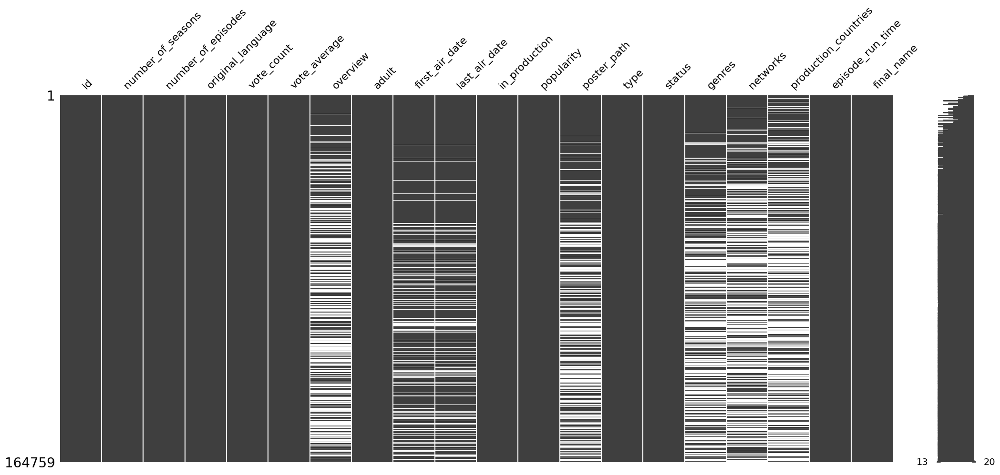

In [ ]:
# Check overall nulls
import missingno as msno
msno.matrix(df_unique)

# בודק את העמודות שנותרו
print(df_unique.columns)

# בודק כמה שורות נשארו
print(df_unique.shape)

# Deal with "dates".

In [ ]:
# Deal with "dates".

# ---  המרת עמודות תאריכים ל-datetime ---
df_unique['first_air_date'] = pd.to_datetime(df_unique['first_air_date'], errors='coerce')
df_unique['last_air_date'] = pd.to_datetime(df_unique['last_air_date'], errors='coerce')

# ---  חליצה של תכונות שימושיות ---

# שנה, חודש, יום של התאריך הראשון
df_unique['first_year'] = df_unique['first_air_date'].dt.year
df_unique['first_month'] = df_unique['first_air_date'].dt.month
df_unique['first_day'] = df_unique['first_air_date'].dt.day

# שנה, חודש, יום של התאריך האחרון
df_unique['last_year'] = df_unique['last_air_date'].dt.year
df_unique['last_month'] = df_unique['last_air_date'].dt.month
df_unique['last_day'] = df_unique['last_air_date'].dt.day


In [ ]:
# עבור תאריכים - נעשה עמודה חדשה
# production_length
# ונשאיר רק את first_year ו last_year


import numpy as np

# נניח שכבר קיימות NaN במקום ערכים חסרים
# חישוב production_length עם NaN
df_unique['production_length'] = df_unique['last_year'] - df_unique['first_year']

# החלפת כל ה-NaN ב-production_length ב- -1
df_unique['production_length'] = df_unique['production_length'].fillna(-1)

# אפשר גם להחליף NaN בעצמות העמודות אם רוצים
df_unique['first_year'] = df_unique['first_year'].fillna(-1)
df_unique['last_year']  = df_unique['last_year'].fillna(-1)

# מחיקת העמודות המיותרות
cols_to_drop = ['first_month', 'first_day', 'last_month', 'last_day', 'first_air_date', 'last_air_date']
df_unique = df_unique.drop(columns=[col for col in cols_to_drop if col in df_unique.columns])

# בדיקה
df_unique[['first_year', 'last_year', 'production_length']].head(10)




,first_year,last_year,production_length
0,2011.0,2019.0,8.0
1,2017.0,2021.0,4.0
2,2016.0,2022.0,6.0
3,2010.0,2022.0,12.0
4,2016.0,2021.0,5.0
5,2017.0,2023.0,6.0
6,2021.0,2021.0,0.0
7,2008.0,2013.0,5.0
8,2017.0,2023.0,6.0
9,2021.0,2021.0,0.0


,id,number_of_seasons,number_of_episodes,original_language,vote_count,vote_average,overview,adult,in_production,popularity,poster_path,type,status,genres,networks,production_countries,episode_run_time,final_name,first_year,last_year,production_length
0,1399,8,73,en,21857,8.442,Seven noble families fight for control of the ...,False,False,1083.917,/1XS1oqL89opfnbLl8WnZY1O1uJx.jpg,Scripted,Ended,"Sci-Fi & Fantasy, Drama, Action & Adventure",HBO,"United Kingdom, United States of America",0,game of thrones,2011.0,2019.0,8.0
1,71446,3,41,es,17836,8.257,"To carry out the biggest heist in history, a m...",False,False,96.354,/reEMJA1uzscCbkpeRJeTT2bjqUp.jpg,Scripted,Ended,"Crime, Drama","Netflix, Antena 3",Spain,70,money heist la casa de papel,2017.0,2021.0,4.0
2,66732,4,34,en,16161,8.624,"When a young boy vanishes, a small town uncove...",False,True,185.711,/49WJfeN0moxb9IPfGn8AIqMGskD.jpg,Scripted,Returning Series,"Drama, Sci-Fi & Fantasy, Mystery",Netflix,United States of America,0,stranger things,2016.0,2022.0,6.0


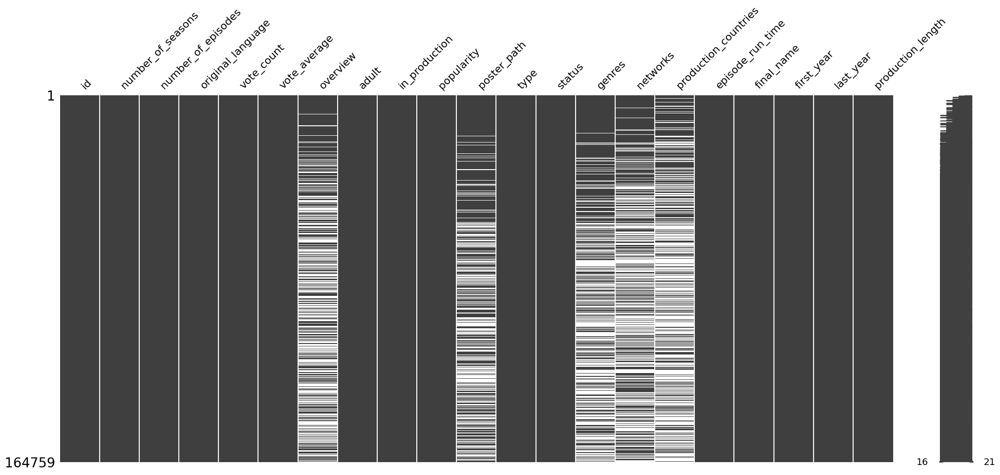

In [ ]:
msno.matrix(df_unique)
df_unique.head(3)

# Remove uninformative column 'poster_path'

In [ ]:
# עמודה שנשארה והיא לא אינפורמטיבית שנוציא אותה
# מחיקת העמודה 'poster_path'
df_unique = df_unique.drop(columns=['poster_path'])

# הצגת רשימת העמודות אחרי המחיקה
print("רשימת העמודות אחרי מחיקה:")
print(df_unique.columns.tolist())


רשימת העמודות אחרי מחיקה:
['id', 'number_of_seasons', 'number_of_episodes', 'original_language', 'vote_count', 'vote_average', 'overview', 'adult', 'in_production', 'popularity', 'type', 'status', 'genres', 'networks', 'production_countries', 'episode_run_time', 'final_name', 'first_year', 'last_year', 'production_length']


In [ ]:

# ניצור טבלת סיכום מקיפה לכל עמודה
summary = pd.DataFrame({
    'non_null_count': df_unique.notnull().sum(),
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes,
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      non_null_count  null_percent  num_unique       data_type
production_countries           75964     53.893869        1247          object
overview                       91681     44.354481       91226          object
networks                       96232     41.592265        8189          object
genres                         97523     40.808696        2227          object
original_language             164759      0.000000         106          object
number_of_episodes            164759      0.000000         967           int64
number_of_seasons             164759      0.000000          82           int64
id                            164759      0.000000      164695           int64
in_production                 164759      0.000000           2            bool
vote_count                    164759      0.000000        1110           int64
vote_average                  164759      0.000000        2603         float64
adult                         164759      0.000000  

# Try to nerrow uniques

In [ ]:
# ערכים ייחודיים בכל עמודה
# רשימת העמודות
columns_to_check = ['type', 'in_production', 'genres', 'status', 'production_countries', 'networks', 'overview']

# הדפסה מסודרת של הערכים הייחודיים עם שם העמודה
for col in columns_to_check:
    print(f"ערכים ייחודיים בעמודה '{col}':")
    print(df_unique[col].unique())
    print("\n" + "-"*50 + "\n")

# מספר הערכים הייחודיים
print("Number of unique values in 'type':", df_unique['type'].nunique())
print("Number of unique values in 'in_production':", df_unique['in_production'].nunique())
print("Number of unique values in 'genres':", df_unique['genres'].nunique())
print("Number of unique values in 'status':", df_unique['status'].nunique())
print("Number of unique values in 'production_countries':", df_unique['production_countries'].nunique())
print("Number of unique values in 'networks':", df_unique['networks'].nunique())

ערכים ייחודיים בעמודה 'type':
['Scripted' 'Miniseries' 'Documentary' 'Reality' 'Talk Show' 'News'
 'Video']

--------------------------------------------------

ערכים ייחודיים בעמודה 'in_production':
[False  True]

--------------------------------------------------

ערכים ייחודיים בעמודה 'genres':
['Sci-Fi & Fantasy, Drama, Action & Adventure' 'Crime, Drama'
 'Drama, Sci-Fi & Fantasy, Mystery' ...
 'Kids, Animation, Comedy, Sci-Fi & Fantasy'
 'Drama, Family, Comedy, Action & Adventure'
 'Comedy, Documentary, Sci-Fi & Fantasy, Mystery']

--------------------------------------------------

ערכים ייחודיים בעמודה 'status':
['Ended' 'Returning Series' 'Canceled' 'Pilot' 'In Production' 'Planned']

--------------------------------------------------

ערכים ייחודיים בעמודה 'production_countries':
['United Kingdom, United States of America' 'Spain'
 'United States of America' ... 'China, Thailand' 'Germany, Brazil'
 'Estonia, Finland']

--------------------------------------------------

ערכים 

In [ ]:
# Show all columns
pd.set_option('display.max_columns', None)
print(df_unique.head(10))

      id  number_of_seasons  number_of_episodes original_language  vote_count  \
0   1399                  8                  73                en       21857   
1  71446                  3                  41                es       17836   
2  66732                  4                  34                en       16161   
3   1402                 11                 177                en       15432   
4  63174                  6                  93                en       13870   
5  69050                  7                 137                en       13180   
6  93405                  2                   9                ko       13053   
7   1396                  5                  62                en       12398   
8  71712                  6                 116                en       11768   
9  85271                  1                   9                en       11308   

   vote_average                                           overview  adult  \
0         8.442  Seven noble fa

In [ ]:
# clean text for editing: remove spaces, capital letters...
# בחירת כל העמודות הטקסטואליות
text_cols = df_unique.select_dtypes(include=['object', 'string']).columns.tolist()
print("עמודות טקסטואליות לניקוי:", text_cols)

# פונקציה לניקוי מחרוזות
def clean_text(val):
    if pd.isnull(val):
        return val  # להשאיר NaN כפי שהוא
    val = str(val).strip().lower()  # הסרת רווחים והמרה לאותיות קטנות
    # ניקוי רווחים סביב פסיקים (לערכים שמופרדים בפסיקים)
    val = ','.join([v.strip() for v in val.split(',')])
    return val

# מחיקת פסיקים מיותרים ורווחים והמרה לאותיות קטנות לכל העמודות הטקסטואליות
for col in text_cols:
    df_unique[col] = df_unique[col].apply(clean_text)

# הצגת דוגמה 10 השורות הראשונות אחרי הניקוי
print(df_unique[text_cols].head(10))

עמודות טקסטואליות לניקוי: ['original_language', 'overview', 'type', 'status', 'genres', 'networks', 'production_countries', 'final_name']
  original_language                                           overview  \
0                en  seven noble families fight for control of the ...   
1                es  to carry out the biggest heist in history,a my...   
2                en  when a young boy vanishes,a small town uncover...   
3                en  sheriff's deputy rick grimes awakens from a co...   
4                en  bored and unhappy as the lord of hell,lucifer ...   
5                en  set in the present,the series offers a bold,su...   
6                ko  hundreds of cash-strapped players accept a str...   
7                en  when walter white,a new mexico chemistry teach...   
8                en  shaun murphy,a young surgeon with autism and s...   
9                en  wanda maximoff and vision—two super-powered be...   

         type            status                

In [ ]:
# Look for uniques in columns: 'production_countries' and 'networks'
# ערכים ייחודיים בכל עמודה
print(df_unique['production_countries'].unique())
print(df_unique['networks'].unique())

# מספר הערכים הייחודיים

print("Number of unique values in 'production_countries':", df_unique['production_countries'].nunique())
print("Number of unique values in 'networks':", df_unique['networks'].nunique())


['united kingdom,united states of america' 'spain'
 'united states of america' ... 'china,thailand' 'germany,brazil'
 'estonia,finland']
['hbo' 'netflix,antena 3' 'netflix' ... 'infinity,focus'
 'kbs2,lg u+,naver now' 'sohu,zhejiang television,youku,iqiyi']
Number of unique values in 'production_countries': 1247
Number of unique values in 'networks': 8141


In [ ]:
# Look for uniques in column: 'episode_run_time'

df_unique['episode_run_time'].unique()

array([   0,   70,   42,   45,   43,   44,   22,   52,   60,   58,   50,
         25,   53,   30,   24,   90,   47,   35,   26,   57,   34,   55,
         41,   65,   39,  130,   40,   10,   21,   11,   80,   77,   36,
         46,   23,   48,   56,   75,   59,   28,   27,   81,   54,   49,
         33,   51,  120,   20,   66,   12,  105,   72,  201,   15,    7,
        100,   93,   64,   31,   18,    8,   85,    4,   14,   78,   37,
         62,   97,    6,   67,   92,   32,   17,   38,    3,    5,   88,
         29,  157,   69,    2,   95,   13,  172,   86,   91,   61,   76,
          9,  160,   68,   87,  118,   63,  140,  184,  170,  519,   84,
        337,   89,  177,  121,  182,   74,  186,  142,  180,  150,   71,
        195,   99,  124,   73,  540,  185,  175,   94,  240,  288,   82,
        167,  162,  110,  217,  168,   96,   19,  156,  132,  126,  155,
        206,  200,  102,  178,  103,   16,    1,  141,  123,  125,   79,
        173,  135,  264,  239,  133,  300,  192,  2

In [ ]:
# Max and Min uniques values in 'episode_run_time'
# מקסימום ומינימום של הערכים הייחודיים
unique_times = df_unique['episode_run_time'].dropna().unique()
min_time = unique_times.min() if hasattr(unique_times, 'min') else min(unique_times)
max_time = unique_times.max() if hasattr(unique_times, 'max') else max(unique_times)

print(f"Minimum episode run time: {min_time} minutes")
print(f"Maximum episode run time: {max_time} minutes")

# ספירה של הערכים 0
num_zeros = (df_unique['episode_run_time'] == 0).sum()
print(f"Number of 0 values in episode_run_time: {num_zeros}")

Minimum episode run time: 0 minutes
Maximum episode run time: 6032 minutes
Number of 0 values in episode_run_time: 81878


In [ ]:
# Check df
summary = pd.DataFrame({
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      null_percent  num_unique data_type
production_countries     53.893869        1247    object
overview                 44.354481       91208    object
networks                 41.592265        8141    object
genres                   40.808696        2227    object
original_language         0.000000         106    object
number_of_episodes        0.000000         967     int64
number_of_seasons         0.000000          82     int64
id                        0.000000      164695     int64
in_production             0.000000           2      bool
vote_count                0.000000        1110     int64
vote_average              0.000000        2603   float64
adult                     0.000000           2      bool
status                    0.000000           6    object
type                      0.000000           7    object
popularity                0.000000       20379   float64
episode_run_time          0.000000         433     int64
final_name                0.000

## Changing strings/objects into category

In [ ]:
# Lets start with the easy columns that have short limitied uniques
categorical_cols = ['original_language', 'type', 'status', 'production_countries', 'networks', 'genres']
for col in categorical_cols:
    df_unique[col] = df_unique[col].astype('category')


In [ ]:
summary = pd.DataFrame({
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      null_percent  num_unique data_type
production_countries     53.893869        1247  category
overview                 44.354481       91208    object
networks                 41.592265        8141  category
genres                   40.808696        2227  category
original_language         0.000000         106  category
number_of_episodes        0.000000         967     int64
number_of_seasons         0.000000          82     int64
id                        0.000000      164695     int64
in_production             0.000000           2      bool
vote_count                0.000000        1110     int64
vote_average              0.000000        2603   float64
adult                     0.000000           2      bool
status                    0.000000           6  category
type                      0.000000           7  category
popularity                0.000000       20379   float64
episode_run_time          0.000000         433     int64
final_name                0.000

In [ ]:
df_unique['production_countries'].value_counts()

,count
production_countries,
japan,9554
united states of america,9181
china,6074
germany,5290
united kingdom,5059
...,...
"united states of america,united kingdom,germany",1
"united states of america,united kingdom,france,italy",1
"united states of america,united kingdom,france,germany,russia,vietnam",1


In [ ]:
# A better overview of 'production_countries' uniques

# מאפשר הדפסת כל הערכים בעמודות ללא קיצוץ
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# סופרים את מספר ההופעות של כל ערך בעמודה production_countries
value_counts = df_unique['production_countries'].value_counts()

# הופך את זה ל-DataFrame להצגה מסודרת
value_counts_df = value_counts.reset_index()
value_counts_df.columns = ['production_countries', 'count']

# מציג את כל הערכים עם מספר ההופעות
print(value_counts_df)

# בסיום, אפשר להחזיר להגדרות ברירת המחדל
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')




                                   production_countries  count
0                                                 japan   9554
1                              united states of america   9181
2                                                 china   6074
3                                               germany   5290
4                                        united kingdom   5059
5                                           south korea   3589
6                                                canada   2819
7                                                france   2810
8                                             hong kong   1912
9                                                brazil   1774
10                                                india   1713
11                                               russia   1383
12                                                spain   1362
13                                              denmark   1275
14                                               turkey

In [ ]:
# Uniques in 'type'
df_unique['type'].value_counts()


,count
type,
scripted,126435
documentary,13420
miniseries,10549
reality,9474
talk show,2934
video,1365
news,582


In [ ]:
# Uniques in 'status'

df_unique['status'].value_counts()

,count
status,
ended,92446
returning series,64894
canceled,4450
in production,2168
planned,569
pilot,232


In [ ]:
# A better overview of 'original_language' uniques

# מאפשר הדפסת כל הערכים בעמודות ללא קיצוץ
pd.set_option('display.max_rows', None)  # מציג כל השורות
pd.set_option('display.max_columns', None)  # מציג כל העמודות

# מציג את כל הערכים ושכיחויות
print(df_unique['original_language'].value_counts())

# בסיום, אפשר להחזיר להגדרות ברירת המחדל
# pd.reset_option('display.max_rows')
# pd.reset_option('display.max_columns')

original_language
en    75142
zh    13810
ja    13782
ko     7671
de     7316
fr     7158
es     5488
pt     3483
ru     2864
nl     2839
ar     2596
da     1960
cn     1815
tr     1736
th     1670
it     1638
hi     1546
sv     1409
cs     1349
no     1182
pl      898
el      892
tl      857
he      524
ms      486
fi      447
id      384
hu      383
sk      381
ur      327
fa      234
bn      224
vi      202
sr      150
ca      139
ta      114
hr      111
ro      110
uk      109
my       97
bg       90
te       84
nb       80
af       68
lt       65
sh       65
ka       54
is       53
sl       50
lv       49
am       48
et       43
mr       37
ml       35
cy       30
kk       29
bs       29
xx       27
ga       25
pa       21
gu       20
sq       20
mt       20
kn       20
gl       18
or       14
ab       12
eu       12
az       11
ku       10
zu        7
mo        7
hy        7
ne        6
si        6
la        5
as        5
km        5
mk        5
gd        4
mi        4
jv        

In [ ]:
# Unit 'original_language' uniques that are under 10 counts

# שפות מתחת ל 10 הפכו להיות OTHER
# עבור original_language

# 1️⃣ ניקוי רווחים ותווים מיותרים בעמודת השפה
df_unique['original_language'] = df_unique['original_language'].astype(str).str.strip().str.lower()

# 2️⃣ ספירת כל הערכים בעמודה
language_counts = df_unique['original_language'].value_counts()

# 3️⃣ זיהוי שפות שמופיעות פחות מ-10 פעמים
rare_languages = language_counts[language_counts < 10].index

# 4️⃣ החלפה של הערכים הנדירים ב-'other' ישירות בעמודה הקיימת
df_unique['original_language'] = df_unique['original_language'].apply(
    lambda x: 'other' if x in rare_languages else x
)

# 5️⃣ הצגת התוצאות
print("התפלגות השפות לאחר איחוד ערכים נדירים:")
print(df_unique['original_language'].value_counts().sort_values(ascending=False))


התפלגות השפות לאחר איחוד ערכים נדירים:
original_language
en       75142
zh       13810
ja       13782
ko        7671
de        7316
fr        7158
es        5488
pt        3483
ru        2864
nl        2839
ar        2596
da        1960
cn        1815
tr        1736
th        1670
it        1638
hi        1546
sv        1409
cs        1349
no        1182
pl         898
el         892
tl         857
he         524
ms         486
fi         447
id         384
hu         383
sk         381
ur         327
fa         234
bn         224
vi         202
sr         150
ca         139
ta         114
hr         111
ro         110
uk         109
other       97
my          97
bg          90
te          84
nb          80
af          68
sh          65
lt          65
ka          54
is          53
sl          50
lv          49
am          48
et          43
mr          37
ml          35
cy          30
bs          29
kk          29
xx          27
ga          25
pa          21
mt          20
kn          2

In [ ]:
# A better overview of 'overview' uniques

df_unique['overview'].head()

,overview
0,seven noble families fight for control of the ...
1,"to carry out the biggest heist in history,a my..."
2,"when a young boy vanishes,a small town uncover..."
3,sheriff's deputy rick grimes awakens from a co...
4,"bored and unhappy as the lord of hell,lucifer ..."


In [ ]:
# Clean text - spaces and other - in 'overview. For further editing
df_unique['overview'] = df_unique['overview'].apply(
    lambda x: x.strip().lower() if isinstance(x, str) else x
)
print(df_unique['overview'].head(20))

0     seven noble families fight for control of the ...
1     to carry out the biggest heist in history,a my...
2     when a young boy vanishes,a small town uncover...
3     sheriff's deputy rick grimes awakens from a co...
4     bored and unhappy as the lord of hell,lucifer ...
5     set in the present,the series offers a bold,su...
6     hundreds of cash-strapped players accept a str...
7     when walter white,a new mexico chemistry teach...
8     shaun murphy,a young surgeon with autism and s...
9     wanda maximoff and vision—two super-powered be...
10    after a particle accelerator causes a freak st...
11    physicists leonard and sheldon find their nerd...
12    after stealing the tesseract during the events...
13    follows the personal and professional lives of...
14    after the fall of the galactic empire,lawlessn...
15    set in springfield,the average american town,t...
16    a group of high school students navigate love ...
17    a dysfunctional family of superheroes come

In [ ]:
# Check results
df_unique['networks'].value_counts()
print(df_unique['networks'].unique())

['hbo', 'netflix,antena 3', 'netflix', 'amc', 'fox,netflix', ..., 'che,dtv,more.tv', 'rcti,azteca trece', 'infinity,focus', 'kbs2,lg u+,naver now', 'sohu,zhejiang television,youku,iqiyi']
Length: 8142
Categories (8141, object): ['#0', '#0,movistar plus+', '#letsdoeit', '&tv', ...,
                            '큐허브,fuji tv', '푸른영상,푸른영상', '플래디', '필콘미디어']


In [ ]:
# # A better overview of 'networks' uniques

# מאפשר הדפסת כל הערכים בעמודות ללא קיצוץ
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# סופרים את מספר ההופעות של כל ערך בעמודה networks
value_counts = df_unique['networks'].value_counts()

# הופכים ל-DataFrame עם עמודות: שם הרשת ומספר ההופעות
value_counts_df = value_counts.reset_index()
value_counts_df.columns = ['network', 'count']

# מציגים את כל הערכים עם מספר ההופעות
print(value_counts_df)

# בסיום, אפשר להחזיר להגדרות ברירת המחדל
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')


                                                network  count
0                                               bbc one   2083
1                                               youtube   1813
2                                                  itv1   1763
3                                               netflix   1749
4                                               bbc two   1607
5                                                   abc   1475
6                                                   nbc   1415
7                                              tvb jade   1361
8                                                   cbs   1323
9                                             channel 4   1241
10                                                  zdf   1035
11                                              fuji tv    936
12                                       cbc television    917
13                                                  ard    834
14                                             tv tokyo

In [ ]:
# Unit 'networks' uniques that are under 10 counts

# 1️⃣ סופרים את מספר ההופעות של כל רשת
network_counts = df_unique['networks'].value_counts()

# 2️⃣ מזהים את הערכים שמופיעים פחות מ-10 פעמים
rare_networks = network_counts[network_counts < 10].index.tolist()

# 3️⃣ מחליפים את הערכים הנדירים ב-'OTHER'
df_unique['networks'] = df_unique['networks'].apply(lambda x: 'OTHER' if x in rare_networks else x)

# 4️⃣ בדיקה: השכיחויות לאחר האיחוד
print("שכיחויות הערכים לאחר איחוד נדירים ל-OTHER:")
print(df_unique['networks'].value_counts())


שכיחויות הערכים לאחר איחוד נדירים ל-OTHER:
networks
OTHER              12490
bbc one             2083
youtube             1813
itv1                1763
netflix             1749
                   ...  
etb2                  10
citra hd              10
rocket beans tv       10
ant1 cy               10
n24                   10
Name: count, Length: 918, dtype: int64


In [ ]:
# Explore 'genres' uniques

df_unique['genres'].value_counts()
print(df_unique['genres'].unique())

['sci-fi & fantasy,drama,action & adventure', 'crime,drama', 'drama,sci-fi & fantasy,mystery', 'action & adventure,drama,sci-fi & fantasy', 'crime,sci-fi & fantasy', ..., 'action & adventure,family,kids,animation,sci-..., 'crime,documentary,news', 'kids,animation,comedy,sci-fi & fantasy', 'drama,family,comedy,action & adventure', 'comedy,documentary,sci-fi & fantasy,mystery']
Length: 2228
Categories (2227, object): ['action & adventure', 'action & adventure,animation',
                            'action & adventure,animation,comedy', 'action & adventure,animation,comedy,crime', ...,
                            'western,sci-fi & fantasy', 'western,sci-fi & fantasy,action & adventure,a...,
                            'western,sci-fi & fantasy,action & adventure,d..., 'western,sci-fi & fantasy,comedy']


In [ ]:
# explore 'genres' unique and clean spaces... for futher editing
# ניקוי ואיחוד ז'אנרים ותיאור אחיד של מילים
# פונקציה לניקוי ולמיון הז'אנרים
def clean_genres(val):
    if pd.isna(val) or val.strip() == '':
        return val
    # פיצול לפי פסיקים, הסרת רווחים, המרה לאותיות קטנות
    items = [x.strip().lower() for x in val.split(',')]
    items.sort()  # מיון אלפביתי
    return ','.join(items)  # חיבור חזרה

# יישום הפונקציה על כל העמודה הקיימת
df_unique['genres'] = df_unique['genres'].apply(clean_genres)

# הצגת השכיחויות של הערכים לאחר הניקוי
print(df_unique['genres'].value_counts().head(100))

# סיכום: כמה ערכים ייחודיים עכשיו בעמודה
num_unique_genres = df_unique['genres'].nunique()
print(f"\nסה\"כ ערכים ייחודיים בעמודה 'genres' לאחר הניקוי: {num_unique_genres}")


genres
documentary                                 17041
drama                                       15985
comedy                                      10181
reality                                      7832
comedy,drama                                 3771
                                            ...  
action & adventure,animation,comedy,kids       56
animation,comedy,drama,sci-fi & fantasy        53
drama,romance                                  53
comedy,crime,mystery                           51
family,talk                                    51
Name: count, Length: 100, dtype: int64

סה"כ ערכים ייחודיים בעמודה 'genres' לאחר הניקוי: 787


In [ ]:
# Unit 'genres' uniques that are under 10 counts

# 1️⃣ ספירת כל הערכים בעמודת genres
counts = df_unique['genres'].value_counts()

# 2️⃣ זיהוי הערכים שמופיעים פחות מ-10 פעמים
to_replace = counts[counts < 10].index.tolist()

# 3️⃣ החלפת הערכים הנדירים ב-'other'
df_unique['genres'] = df_unique['genres'].apply(
    lambda x: 'other' if x in to_replace else x
)

# 4️⃣ בדיקה: הצגת ההתפלגות לאחר האיחוד
value_counts = df_unique['genres'].value_counts()
print(value_counts)

# 5️⃣ הצגת סיכום מספר הערכים הייחודיים לאחר האיחוד
print(f"\nסה\"כ ערכים ייחודיים בעמודה 'genres' לאחר האיחוד: {df_unique['genres'].nunique()}")


genres
documentary                    17041
drama                          15985
comedy                         10181
reality                         7832
comedy,drama                    3771
                               ...  
comedy,drama,kids                 10
documentary,drama,family          10
animation,comedy,crime            10
drama,kids,sci-fi & fantasy       10
comedy,documentary,drama          10
Name: count, Length: 235, dtype: int64

סה"כ ערכים ייחודיים בעמודה 'genres' לאחר האיחוד: 235


In [ ]:
# To have an overview of missing data and types of data

# ניצור טבלת סיכום מקיפה לכל עמודה
summary = pd.DataFrame({
    'non_null_count': df_unique.notnull().sum(),
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes,
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      non_null_count  null_percent  num_unique data_type
production_countries           75964     53.893869        1247  category
overview                       91681     44.354481       91208    object
networks                       96232     41.592265         918    object
genres                         97523     40.808696         235    object
original_language             164759      0.000000          71    object
number_of_episodes            164759      0.000000         967     int64
number_of_seasons             164759      0.000000          82     int64
id                            164759      0.000000      164695     int64
in_production                 164759      0.000000           2      bool
vote_count                    164759      0.000000        1110     int64
vote_average                  164759      0.000000        2603   float64
adult                         164759      0.000000           2      bool
status                        164759      0.000000 

In [ ]:
# רשימת העמודות שיישמרו כ-object
keep_object = ['overview', 'final_name']

# המרה של כל שאר העמודות מסוג object ל-category
for col in df_unique.select_dtypes(include=['object']).columns:
    if col not in keep_object:
        df_unique[col] = df_unique[col].astype('category')

# בדיקה
# ניצור טבלת סיכום מקיפה לכל עמודה
summary = pd.DataFrame({
    'non_null_count': df_unique.notnull().sum(),
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes,
}).sort_values(by='null_percent', ascending=False)

print(summary)


                      non_null_count  null_percent  num_unique data_type
production_countries           75964     53.893869        1247  category
overview                       91681     44.354481       91208    object
networks                       96232     41.592265         918  category
genres                         97523     40.808696         235  category
original_language             164759      0.000000          71  category
number_of_episodes            164759      0.000000         967     int64
number_of_seasons             164759      0.000000          82     int64
id                            164759      0.000000      164695     int64
in_production                 164759      0.000000           2      bool
vote_count                    164759      0.000000        1110     int64
vote_average                  164759      0.000000        2603   float64
adult                         164759      0.000000           2      bool
status                        164759      0.000000 

# EDA

In [ ]:
!pip install autoviz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.5/67.5 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.5/175.5 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 255.9/255.9 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 608.4/608.4 kB 23.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 49.9 MB/s eta 0:00:00
  Attempting uninstall: xgboost
    Found existing installation: xgboost 3.1.1
    Uninstalling xgboost-3.1.1:
      Successfully uninstalled xgboost-3.1.1


In [ ]:
!pip install textblob
!python -m textblob.download_corpora


[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data] Downloading package conll2000 to /root/nltk_data...
[nltk_data]   Unzipping corpora/conll2000.zip.
[nltk_data] Downloading package movie_reviews to /root/nltk_data...
[nltk_data]   Unzipping corpora/movie_reviews.zip.
Finished.


### EDA reports

    Since nrows is smaller than dataset, loading random sample of 30000 rows into pandas...
Shape of your Data Set loaded: (30000, 20)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing up to 30 columns (max) in each category:
    Numeric Columns : ['vote_average', 'first_year', 'last_year', 'production_length']
    Integer-Categorical Columns: ['id', 'number_of_seasons', 'number_of_episodes', 'vote_count', 'episode_run_time']
    String-Categorical Columns: []
    Factor-Categorical Columns: ['original_language', 'type', 'status', 'genres', 'networks', 'production_countries']
    String-Boolean Columns: ['adult', 'in_production']
    Numeric-Boolean Columns: []
    Discrete String Columns: []
    NLP text Columns: ['final_name',

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
id,int64,0.000000,99,5.000000,251213.000000,No issue
number_of_seasons,int64,0.000000,0,0.000000,84.000000,Column has 9914 outliers greater than upper bound (1.00) or lower than lower bound(1.00). Cap them or remove them.
number_of_episodes,int64,0.000000,1,0.000000,20839.000000,Column has 3021 outliers greater than upper bound (48.50) or lower than lower bound(-27.50). Cap them or remove them.
original_language,category,0.000000,0,,,55 rare categories: Too many to list. Group them into a single category or drop the categories.
vote_count,int64,0.000000,1,0.000000,13053.000000,Column has 4718 outliers greater than upper bound (2.50) or lower than lower bound(-1.50). Cap them or remove them.
vote_average,float64,0.000000,NA,0.000000,10.000000,No issue
overview,object,43.770000,56,,,"13131 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: object, float,"
adult,bool,0.000000,0,0.000000,1.000000,No issue
in_production,bool,0.000000,0,0.000000,1.000000,No issue
type,category,0.000000,0,,,"2 rare categories: ['video', 'news']. Group them into a single category or drop the categories."


Number of All Scatter Plots = 10


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

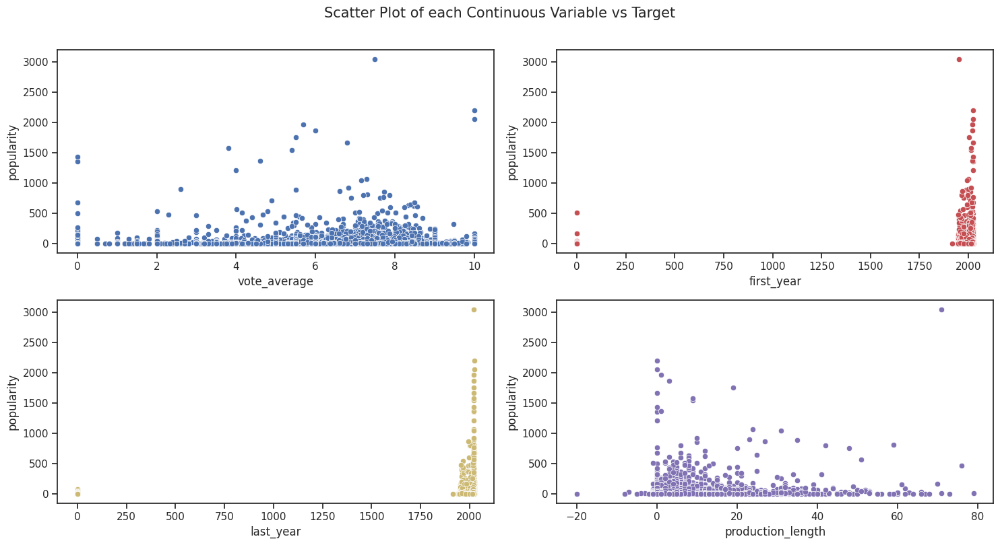

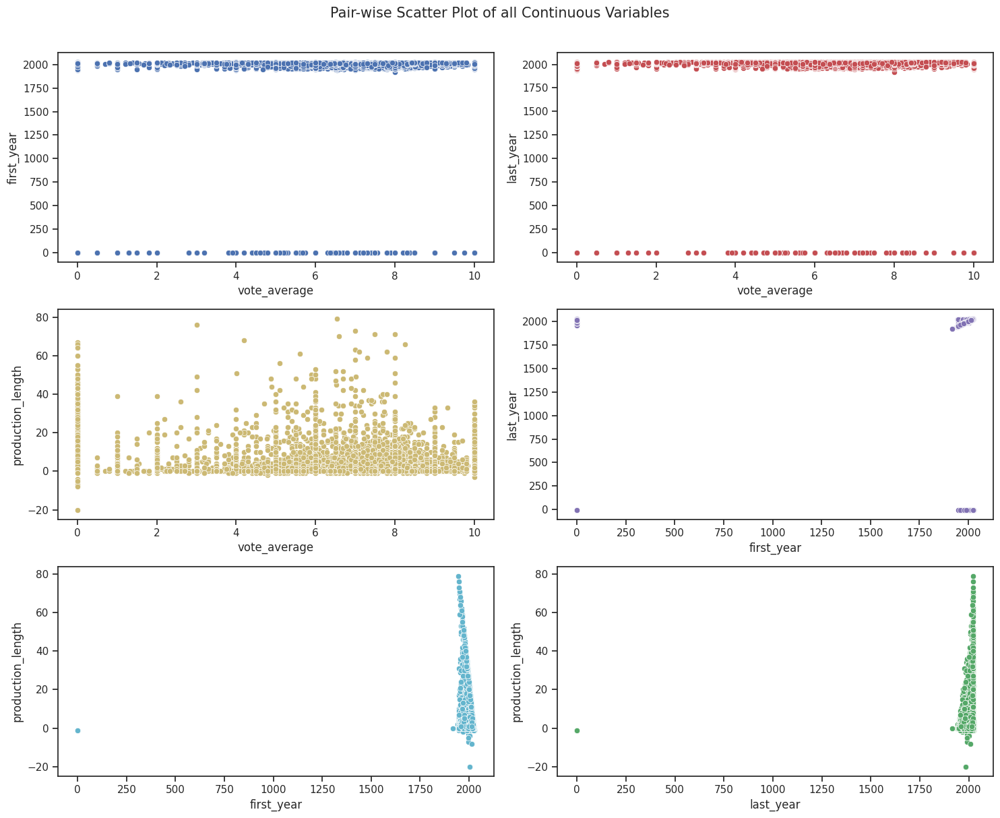

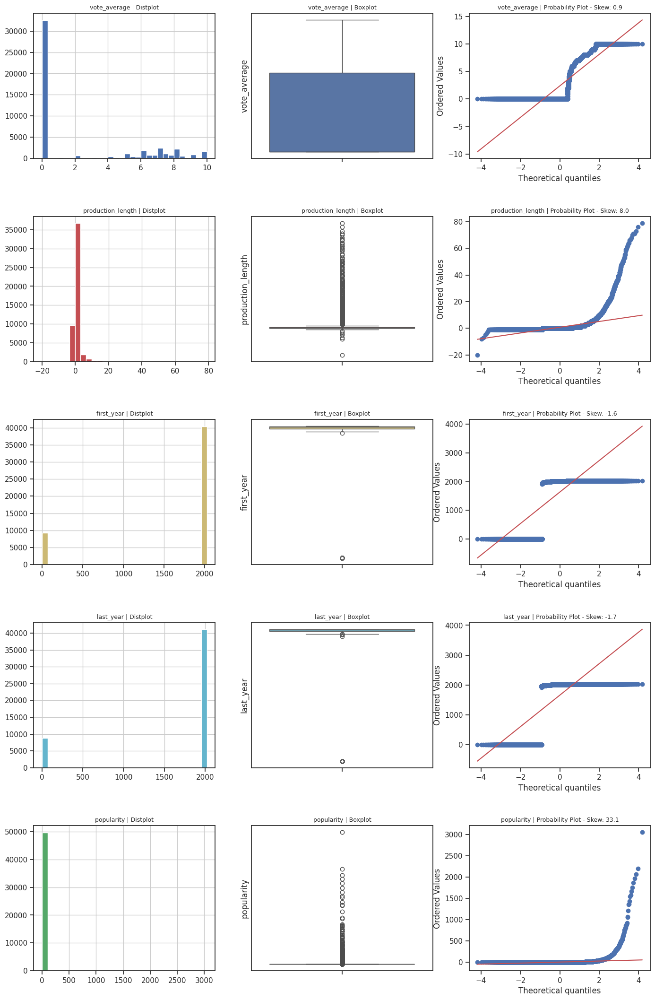

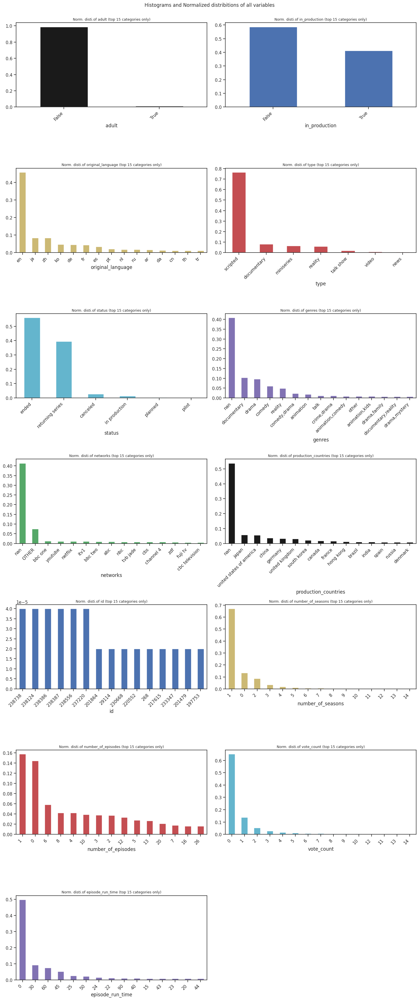

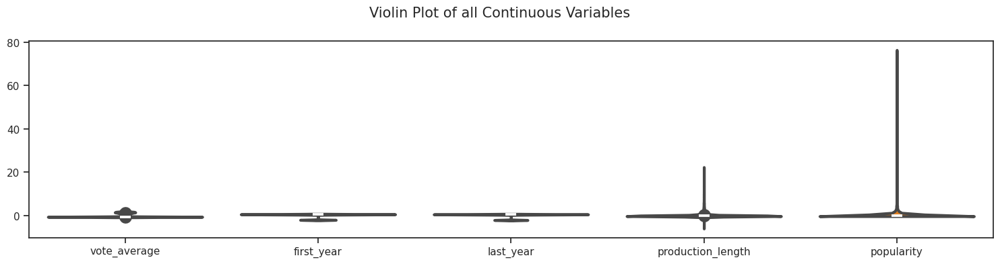

...

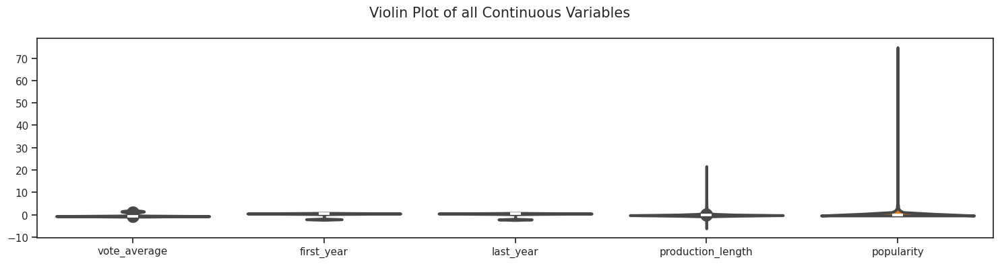

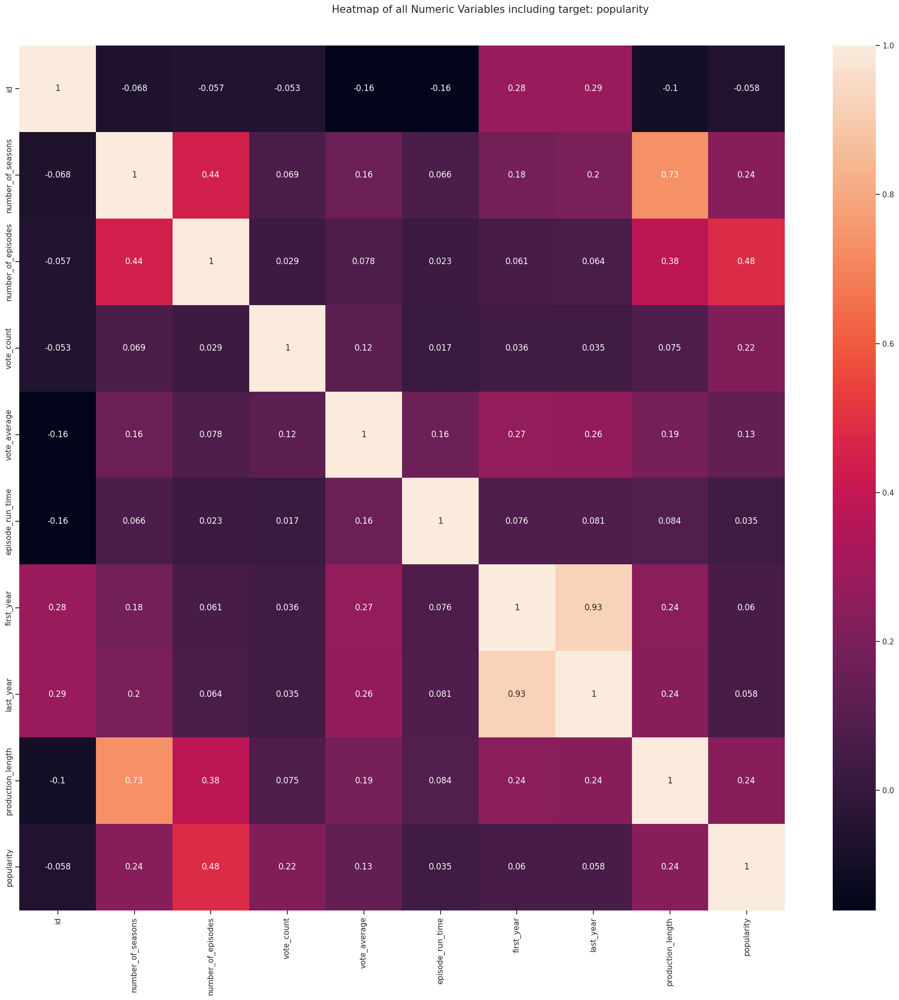

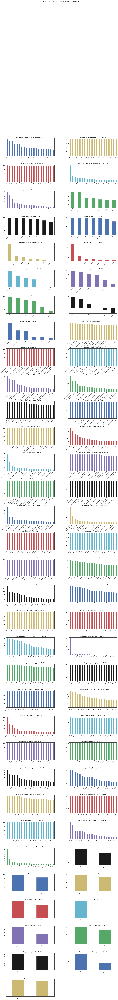

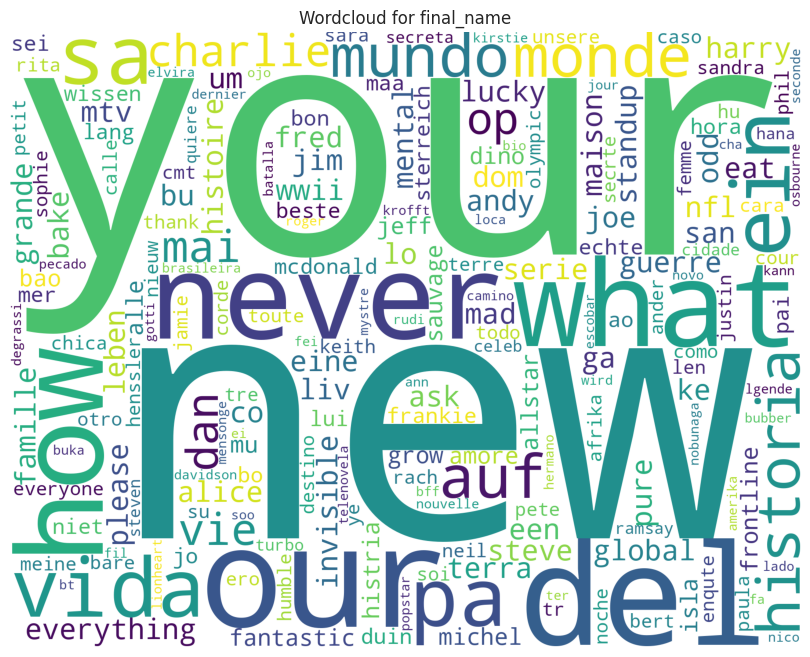

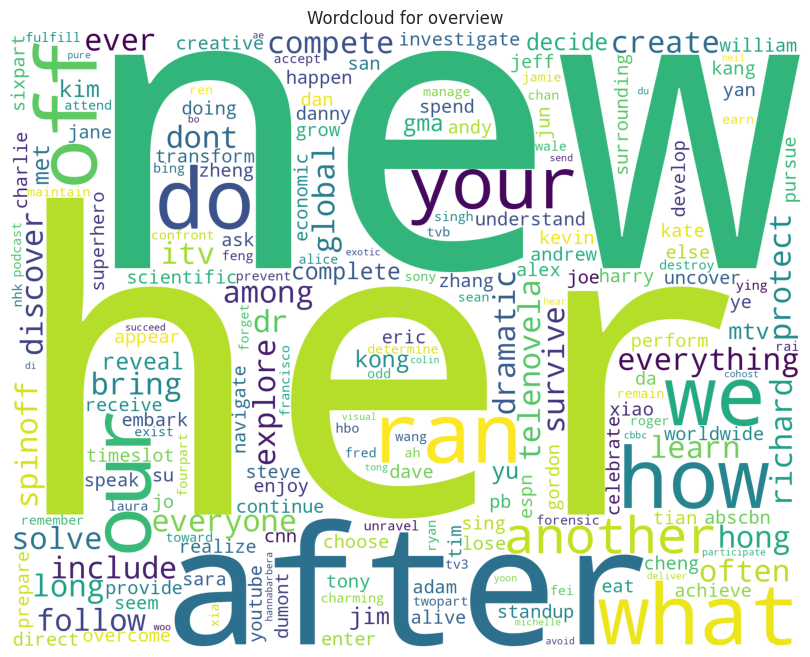

All Plots are saved in ./AutoViz_Plots/popularity
Time to run AutoViz = 111 seconds 


In [ ]:
# AutoViz report - Popularity as Target


%matplotlib inline
from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()

df_auto = AV.AutoViz(
    filename="",
    dfte=df_unique,
    depVar="popularity",
    sep=",",
    chart_format="png",   # תומך יותר מכל
    max_rows_analyzed=30000,
    verbose=2             # מציג מידע נוסף בהרצה
)


In [ ]:
# ydata-profiling report

# התקנה (אם טרם הותקן)
!pip install ydata-profiling --quiet

# ייבוא הספרייה
from ydata_profiling import ProfileReport
import pandas as pd

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.3/399.3 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 36.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 34.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 1.7 MB/s eta 0:00:00


In [ ]:


# יצירת דו"ח
profile = ProfileReport(df_unique, title="EDA Report - Dataset Overview", explorative=True)

# להצגה ישירה במחברת (Jupyter / Colab)
profile.to_notebook_iframe()

# או לשמירה לקובץ HTML
profile.to_file("EDA_report.html")

print("✅ דו\"ח EDA נוצר ונשמר כ-'EDA_report.html'")


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 20/20 [00:52<00:00,  2.61s/it]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

✅ דו"ח EDA נוצר ונשמר כ-'EDA_report.html'


In [ ]:
profile.to_file("EDA_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:

from google.colab import files
files.download("EDA_report.html")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Data cleansing

In [ ]:
# Dealing with missing values
# ניצור טבלת סיכום מקיפה לכל עמודה
summary = pd.DataFrame({
    'non_null_count': df_unique.notnull().sum(),
    'null_percent': df_unique.isnull().mean() * 100,
    'num_unique': df_unique.nunique(),
    'data_type': df_unique.dtypes,
}).sort_values(by='null_percent', ascending=False)

print(summary)

                      non_null_count  null_percent  num_unique data_type
production_countries       75964        53.893869       1247    category
overview                   91681        44.354481      91208      object
networks                   96232        41.592265        918    category
genres                     97523        40.808696        235    category
original_language         164759         0.000000         71    category
number_of_episodes        164759         0.000000        967       int64
number_of_seasons         164759         0.000000         82       int64
id                        164759         0.000000     164695       int64
in_production             164759         0.000000          2        bool
vote_count                164759         0.000000       1110       int64
vote_average              164759         0.000000       2603     float64
adult                     164759         0.000000          2        bool
status                    164759         0.000000  

In [ ]:
!pip install fancyimpute

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.7/154.7 kB 4.6 MB/s eta 0:00:00
  Created wheel for fancyimpute: filename=fancyimpute-0.7.0-py3-none-any.whl size=29879 sha256=17c211936aa379bee5a28edf6618c1d95b15ce4923fafcd142f5b3e861dfa9a1
  Stored in directory: /root/.cache/pip/wheels/df/20/91/e4850b9a31cf660c1bc95515d3bcbc8010e869e5de6d5baf07
  Created wheel for knnimpute: filename=knnimpute-0.1.0-py3-none-any.whl size=11331 sha256=13593cc828865ef0a3d05d2960bd67864d483f1a69c7a995164fffb0963647eb
  Stored in directory: /root/.cache/pip/wheels/89/11/61/aa5a3167bfff49218cd043a73a83034b9eadd858b0059521be
Successfully built fancyimpute knnimpute


In [ ]:
# MICE - to fill missing values in 'overview'

import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder
from fancyimpute import IterativeImputer

# -----------------------------
# 0️⃣ מילוי חוסרים ב-overview
# -----------------------------
# ממלא NaN
df_unique['overview'] = df_unique['overview'].fillna("unknown")
# מסיר רווחים וממירה לאותיות קטנות
df_unique['overview'] = df_unique['overview'].apply(lambda x: x.strip().lower() if isinstance(x, str) else x)
# ממלא מחרוזות ריקות ב-"unknown"
df_unique.loc[df_unique['overview'] == "", 'overview'] = "unknown"

# -----------------------------
# 1️⃣ יצירת TF-IDF מה-overview (למטרת MICE בלבד)
# -----------------------------
vectorizer = TfidfVectorizer(max_features=100)
overview_tfidf = vectorizer.fit_transform(df_unique['overview']).toarray()
overview_df = pd.DataFrame(overview_tfidf, columns=[f"word_{i}" for i in range(overview_tfidf.shape[1])])

# -----------------------------
# 2️⃣ המרת קטגוריות ל-numeric
# -----------------------------
categorical_cols = ['genres', 'networks', 'production_countries', 'type', 'status', 'adult']
le_dict = {}

for col in categorical_cols:
    if pd.api.types.is_categorical_dtype(df_unique[col]):
        df_unique[col] = df_unique[col].cat.add_categories(["Unknown"])
    df_unique[col] = df_unique[col].fillna("Unknown")

    le = LabelEncoder()
    df_unique[col] = le.fit_transform(df_unique[col])
    le_dict[col] = le

# -----------------------------
# 3️⃣ הכנת דאטה ל-MICE (numeric בלבד + TF-IDF)
#    ✅ הוצאת id כדי לא לפגוע ב-MICE
# -----------------------------
numeric_cols = df_unique.select_dtypes(include=['int64', 'float64']).columns.tolist()
numeric_cols = [col for col in numeric_cols if col != 'id']  # <-- כאן הוספנו את התיקון

df_for_mice = pd.concat([df_unique[numeric_cols], overview_df], axis=1)

# -----------------------------
# 4️⃣ ריצת MICE
# -----------------------------
imp = IterativeImputer(max_iter=10, random_state=0)
df_filled_array = imp.fit_transform(df_for_mice)
df_filled = pd.DataFrame(df_filled_array, columns=df_for_mice.columns)

# -----------------------------
# 5️⃣ החזרת קטגוריות למצב טקסט
# -----------------------------
for col in categorical_cols:
    le = le_dict[col]
    df_filled[col] = df_filled[col].round().astype(int)
    df_filled[col] = le.inverse_transform(df_filled[col])

# -----------------------------
# 6️⃣ החזרת overview המקורי (שכבר מלא בהשלמות)
# -----------------------------
df_filled['overview'] = df_unique['overview']

# -----------------------------
# 7️⃣ מחיקת עמודות TF-IDF
# -----------------------------
tfidf_cols = [col for col in df_filled.columns if col.startswith("word_")]
df_filled.drop(columns=tfidf_cols, inplace=True)

# -----------------------------
# 8️⃣ החזרת כל העמודות הטקסטואליות המקוריות שלא עברו MICE
# -----------------------------
non_numeric_cols = df_unique.select_dtypes(exclude=['int64', 'float64']).columns.tolist()
for col in non_numeric_cols:
    if col != 'overview':  # overview כבר הוספנו
        df_filled[col] = df_unique[col]

# -----------------------------
# ✅ החזרת עמודת id כמו שהיא
# -----------------------------
df_filled['id'] = df_unique['id']

# -----------------------------
# 9️⃣ בדיקה
# -----------------------------
print("מספר ערכים חסרים אחרי כל התהליך:")
print(df_filled.isnull().sum())


מספר ערכים חסרים אחרי כל התהליך:
number_of_seasons       0
number_of_episodes      0
vote_count              0
vote_average            0
adult                   0
popularity              0
type                    0
status                  0
genres                  0
networks                0
production_countries    0
episode_run_time        0
first_year              0
last_year               0
production_length       0
overview                0
original_language       0
in_production           0
final_name              0
id                      0
dtype: int64


# new dataframe - df_filled

In [ ]:
# File check
df_filled.info()

In [ ]:


from google.colab import files

df_filled.to_csv('df_new_GitHub.csv', index=False)
files.download('df_new_GitHub.csv')



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Continue in second file